In [2]:

from IPython.display import HTML
from sklearn.feature_selection import SelectKBest, chi2

# ----------------------------------------

# venv310:
from ydata_profiling import ProfileReport
from autoviz.AutoViz_Class import AutoViz_Class
import sweetviz as sv
from phik import resources, report
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

ModuleNotFoundError: No module named 'sklearn'

<h1><center>
  Loading and Analyzing Customer Churn
</h1>

### Dataset Description for Regression (Customer Value)

This dataset comes from an Iranian telecom company and contains 3150 rows, where each row represents a customer.<br> The dataset has 13 features and is used to understand customer behavior. For regression, the goal is to predict **Customer Value** (a continuous number).

## Features for Regression (Customer Value):
1. **Call Failure**: Number of times calls failed.
2. **Complains**: 0 = No complaints, 1 = Complained.
3. **Subscription Length**: How long the customer has been subscribed (in months).
4. **Charge Amount**: Total amount charged to the customer.
5. **Seconds of Use**: Total seconds the customer used the service.
6. **Frequency of Use**: How often the customer used the service.
7. **Frequency of SMS**: How many SMS messages the customer sent.
8. **Distinct Called Numbers**: Number of unique phone numbers the customer called.
9. **Age Group**: Age category of the customer.
10. **Tariff Plan**: Type of plan the customer is using.
11. **Status**: Whether the customer is active or inactive (0 or 1).
12. **Age**: Customer’s exact age.
13. **Churn**: 0 = Did not leave the service, 1 = Left the service.
14. **Customer Value**: Represents how much value or revenue the customer has brought to the company.

In [12]:
# Loading the Dataset
data = pd.read_csv("Datasets/Customer Churn.csv")
data.head(5)

,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
0,8,0,38,0,4370,71,5,17,3,1,1,30,197.640,0
1,0,0,39,0,318,5,7,4,2,1,2,25,46.035,0
2,10,0,37,0,2453,60,359,24,3,1,1,30,1536.520,0
3,10,0,38,0,4198,66,1,35,1,1,1,15,240.020,0
4,3,0,38,0,2393,58,2,33,1,1,1,15,145.805,0


In [13]:
# Analyzing the dataset with DataPrep library
#report = create_report(data)
#report.show_browser()
#Save the report to a file
#report.save("Datasets/customer_churn_report.html")


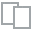
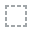
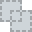
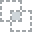
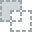
...
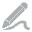
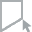
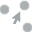
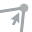
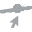

In [14]:
# Loading the customer_churn_report.html file
HTML(filename="Datasets/customer_churn_report.html")

## <span style="color: #20C997;">Personal Analysis</span>
With quick looking at overview, The dataset has 3,150 rows and 14 features (8 numeric, 6 categorical) with no missing data but 300 duplicate rows.<br>
<br>1-The Call Failure is right skewed and has 702 zero values, but these zero values have meaning<br><br>
2-The Complains is categorical column with two values (0 and 1). It is imbalanced feature, with 2,909 entries (92.3%) 0 and only 241 entries (7.7%) are 1.<br>
<br>3-The Subscription Length feature goes from 3 to 47, with an average of 32.5 and a middle value of 35. Most values are between 30 and 38, and the data is skewed to the left. The values are spread out by about 8.57 on average (standard deviation).<br>
<br>4-The Charge Amount is skewed and  values are between 0 to 10, with an average of 0.94 . Over half of the values (56.1%) are zero. which means more than half of the customers might not use the service.<br>


<br>5-The Seconds of Use values are between 0 to 17,090, with an average of 4,472.5 and a middle of 2,990. Around 4.9% of the values are zero which means 4.9% of customers did not use the service for second time. The data has a wide range, standard deviation is 4,197.9. The data is skewed to the right. <br>

<br>6-The Frequency of Use feature ranges from 0 to 255, with an average of 69.5 and median of 54. About 4.9% of the values are zero. The data is right-skewed, w The standard deviation is 57.<br>

<br>7-The Frequency of SMS feature range from 0 to 522, with an average of 73.2 and a median of 21. Around 19.1% of the values are zero which means many users sent no SMS. The data is right skewed. The standard deviation is 112.<br>

<br>8-The Distinct Called Numbers feature ranges from 0 to 97, with an average of 23.5 and a median of 21. About 4.9% of values are zero. The data is right skewed which means more customers call fewer unique numbers, but there are some customers with a high number of distinct call.<br>

<br>9-The Age Group feature has 5 categories, the most common category is 3, with 1,425 entries, 2 is 1,037 entries.<br>

<br>10-The Tariff Plan feature has two categories, with the first category (1) having 2,905 entries and the second category (2) having 245 entries. It is  imbalanced distribution.<br>

<br>11-The Age feature is categorical with 5 distinct values (15, 25, 30, 45, 55). The most frequent age group is 30.<br>

<br>12-The Customer Value feature ranges from 0 to 2165.28, with an average of 470.97 and median of 228.48. About 4.2% of the values are zero, which means some customers are not active or have no recording.A few customers having much higher values than most. The standard deviation is 517.02, showing that the values vary a lot, and the middle 50% of values are between 113.80 and 788.39.<br>

<br>13-The Churn feature has two categories: 0  and 1. (about 84%) are non-churners, and 495 entries (about 16%) are churners and the column is imbalanced.

Charge amount has correlation with call failure. Scatter plot shows customers who have charge amount between 0-3 have higher call failure and customers with 9 and 10 charge amount has lowest call failure.<br>
Second of Usage is related with call failure and charge amount.<br>
Frequency of use has very strong correlation with Seconds of usage almost 0.95, it makes sense seconds of usage is cause of Frequency of use. <br>
Frequency of use has strong correlation with call failure, which means when you have call failure and you try to recall.<br>
Frequency of use is related to charge amount as well, it makes sense when you have money so you can call frequently.<br>
Distinct has correlation with call failure, charge amount, seconds of use and frequency of of use.<br>
Status has negative correlation with charge amount, seconds of use, frequency of use, frequency of sms and distinct call.<br>
Age has correlation with charge amount and strong correlation with age group.<br>
Customer value has correlation with Second of use and frequency of use and it has very strong correlation with frequency sms.<br>
Customer value has negative correlation with age and strong negative correlation with status.<br>
Churn has correlation with Complains and status, also has negative correlation with charge amount, seconds of use, frequency of call/sms, distinct call and customer value.

In [15]:
# Analyzing the dataset with Pandas Profiling
profile = ProfileReport(data, title='Pandas Profiling Report')
# Display the report
profile.to_notebook_iframe()   
# Saving the report to a file in HTML format
profile.to_file("Datasets/customer_churn_Pandas_Profiling_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## <span style="color: #20C997;">Personal Analysis</span>
Panda Profile shows 22 alerts, Dataset has 165 duplicated rows, as on the above is mentioned many columns have correlation. Complains and status are imbalance, and some columns have zero values.

In [16]:
# Analyzing with Sweetviz
report = sv.analyze(data)
report.show_html("Datasets/customer_churn_sweet.html")

                                             |          | [  0%]   00:00 -> (? left)

Report Datasets/customer_churn_sweet.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


## <span style="color: #20C997;">Personal Analysis</span>
SweetViz does not provide new insights what Data Prep and Panda profile did not.

In [17]:
AV = AutoViz_Class()
# Visualize the dataset
dft = AV.AutoViz(data)

Shape of your Data Set loaded: (3150, 14)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  1
    Number of Integer-Categorical Columns =  9
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  4
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    14 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
To fix these data quality issues in the dataset, import FixDQ from autoviz...
There are 300 d

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Call Failure,int64,0.000000,1,0.000000,36.000000,Column has 44 outliers greater than upper bound (28.50) or lower than lower bound(-15.50). Cap them or remove them.
Complains,int64,0.000000,0,0.000000,1.000000,No issue
Subscription Length,int64,0.000000,1,3.000000,47.000000,Column has 208 outliers greater than upper bound (51.50) or lower than lower bound(15.50). Cap them or remove them.
Charge Amount,int64,0.000000,0,0.000000,10.000000,Column has 62 outliers greater than upper bound (5.00) or lower than lower bound(-3.00). Cap them or remove them.
Seconds of Use,int64,0.000000,61,0.000000,17090.000000,Column has 189 outliers greater than upper bound (14061.88) or lower than lower bound(-6103.12). Cap them or remove them.
Frequency of use,int64,0.000000,8,0.000000,255.000000,"Column has 118 outliers greater than upper bound (198.00) or lower than lower bound(-74.00). Cap them or remove them., Column has a high correlation with ['Seconds of Use']. Consider dropping one of them."
Frequency of SMS,int64,0.000000,14,0.000000,522.000000,"Column has 333 outliers greater than upper bound (209.50) or lower than lower bound(-114.50). Cap them or remove them., Column has a high correlation with ['Customer Value']. Consider dropping one of them."
Distinct Called Numbers,int64,0.000000,3,0.000000,97.000000,Column has 82 outliers greater than upper bound (68.50) or lower than lower bound(-23.50). Cap them or remove them.
Age Group,int64,0.000000,0,1.000000,5.000000,Column has 154 outliers greater than upper bound (4.50) or lower than lower bound(0.50). Cap them or remove them.
Tariff Plan,int64,0.000000,0,1.000000,2.000000,No issue


All Plots done
Time to run AutoViz = 5 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


## <span style="color: #20C997;">Personal Analysis</span>
The shape of dataset is 3150 rows and 14 features.<br>
It seems more columns have outliers.

In [18]:
# Calculate the phik matrix
phik_overview = data.phik_matrix()
phik_overview

interval columns not set, guessing: ['Call  Failure', 'Complains', 'Subscription  Length', 'Charge  Amount', 'Seconds of Use', 'Frequency of use', 'Frequency of SMS', 'Distinct Called Numbers', 'Age Group', 'Tariff Plan', 'Status', 'Age', 'Customer Value', 'Churn']


,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
Call Failure,1.000000,0.221391,0.393630,0.710498,0.637996,0.717011,0.302474,0.626590,0.241750,0.293079,0.158626,0.241750,0.524792,0.045643
Complains,0.221391,1.000000,0.179273,0.081930,0.206787,0.186296,0.163629,0.101599,0.056053,0.000000,0.410767,0.056053,0.186653,0.739841
Subscription Length,0.393630,0.179273,1.000000,0.320153,0.409170,0.467856,0.503407,0.502920,0.370226,0.299681,0.253007,0.370226,0.374263,0.282007
Charge Amount,0.710498,0.081930,0.320153,1.000000,0.668243,0.608364,0.317253,0.537064,0.510310,0.478096,0.418550,0.510310,0.418279,0.229603
Seconds of Use,0.637996,0.206787,0.409170,0.668243,1.000000,0.929748,0.709112,0.818612,0.609349,0.406160,0.758516,0.609349,0.808966,0.459374
Frequency of use,0.717011,0.186296,0.467856,0.608364,0.929748,1.000000,0.670599,0.867369,0.508050,0.547833,0.688190,0.508050,0.816699,0.440846
Frequency of SMS,0.302474,0.163629,0.503407,0.317253,0.709112,0.670599,1.000000,0.551520,0.392132,0.584950,0.448676,0.392132,0.916134,0.330681
Distinct Called Numbers,0.626590,0.101599,0.502920,0.537064,0.818612,0.867369,0.551520,1.000000,0.518729,0.285493,0.579485,0.518729,0.673250,0.385619
Age Group,0.241750,0.056053,0.370226,0.510310,0.609349,0.508050,0.392132,0.518729,1.000000,0.157408,0.161201,1.000000,0.471688,0.108035
Tariff Plan,0.293079,0.000000,0.299681,0.478096,0.406160,0.547833,0.584950,0.285493,0.157408,1.000000,0.251459,0.157408,0.562542,0.160633


## <span style="color: #20C997;">Personal Analysis</span>
The Phik matrix shows: <br>
1- Call failure has strong correlation with charge amount, it makes sense, when you do not have enough charge amount so you have call failure.<br>
Also it has correlation with second of use, Frequency of use, distinct called numbers and customer.<br>
2- Complains has correlation with Churn and status.<br>
3- Subscription has correlation with Seconds of use, frequency of use/sms and age.<br>
4- Charge amount has correlation with seconds of use, frequency of use/sms and distinct called numbers, these make sense, when you call a lot and send sms more so you need more charge amount.<br>
5- Phik matrix shows higher correlation between seconds of use and Distinct Called Numbers, and also between seconds of use and customer value than Data Prep.<br>
6- For frequency of use, Phik matrix shows higher correlation with customer value.<br>

## <span style="color: #20C997;">Future Operation Plan For Churn Dataset:</span>
1-Handling imbalanced.<br>
2-Dealing with outliers.<br>
3-Removing duplicate rows.<br>
4-Dealing with mulicollinearity and redundancy.<br>
5-Feature engineering.<br>
6-Scaling and normalizing the features.<br>
7-Modeling.<br>
8-Evaluating.<br>
9-Tune the parameters.<br>


<h1 style="
    font-family: 'Arial', sans-serif;
    font-size: 2.5em;
    background: linear-gradient(90deg, #FF7F50, #1E90FF);
    -webkit-background-clip: text;
    -webkit-text-fill-color: transparent;
    text-align: center;
    text-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    margin-bottom: 20px;
    padding: 10px;
">
  Advanced tasks
</h1>

In [19]:
%matplotlib inline

In [20]:
df.head()

,UDI,Product ID,Type,Air temperature [C],Process temperature [C],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
0,1,M14860,M,24.95,35.45,1551,42.8,0,0,0,0,0,0,0
1,2,L47181,L,25.05,35.55,1408,46.3,3,0,0,0,0,0,0
2,3,L47182,L,24.95,35.35,1498,49.4,5,0,0,0,0,0,0
3,4,L47183,L,25.05,35.45,1433,39.5,7,0,0,0,0,0,0
4,5,L47184,L,25.05,35.55,1408,40.0,9,0,0,0,0,0,0


Text(0.5, 1.0, 'Rotational speed [rpm] vs. Torque [Nm]')

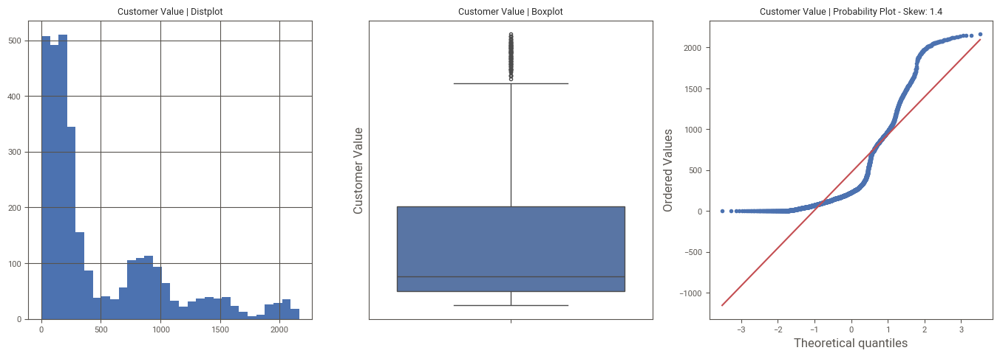

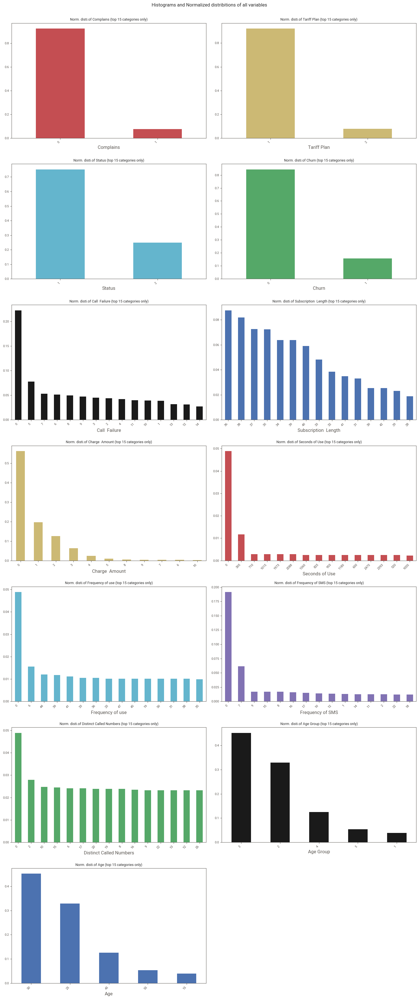

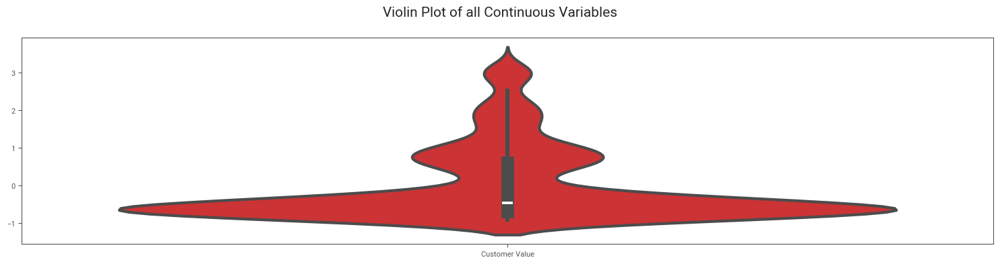

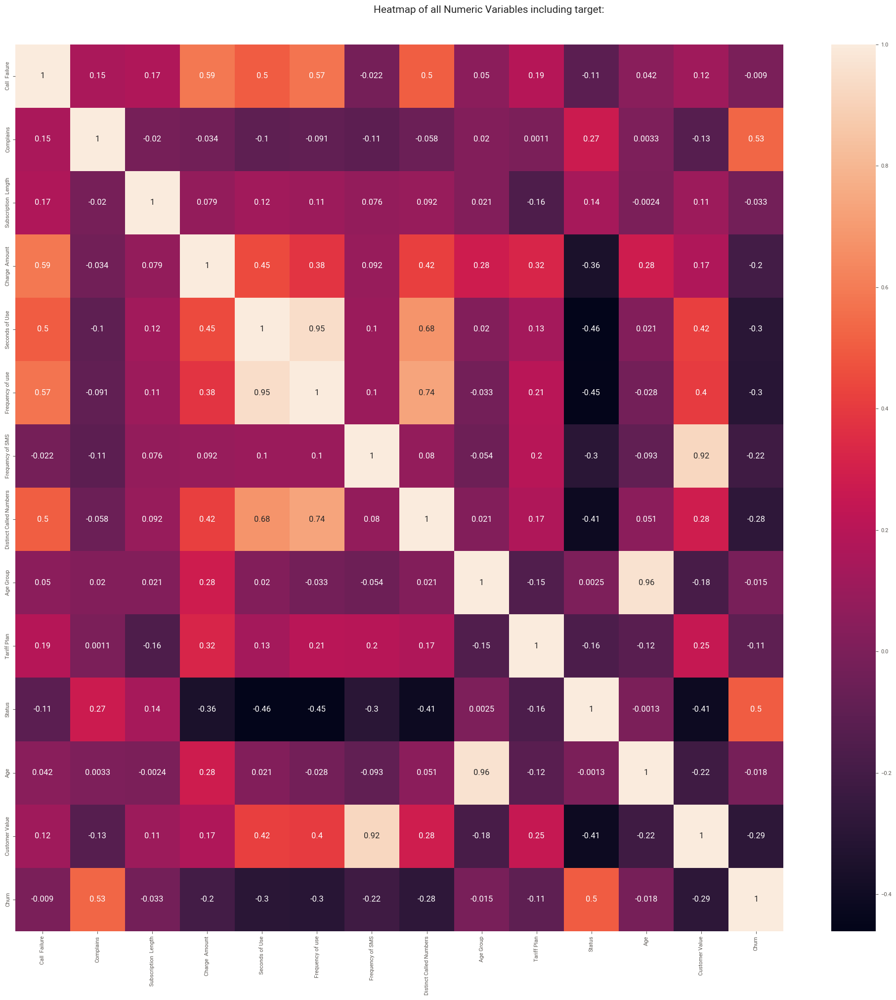

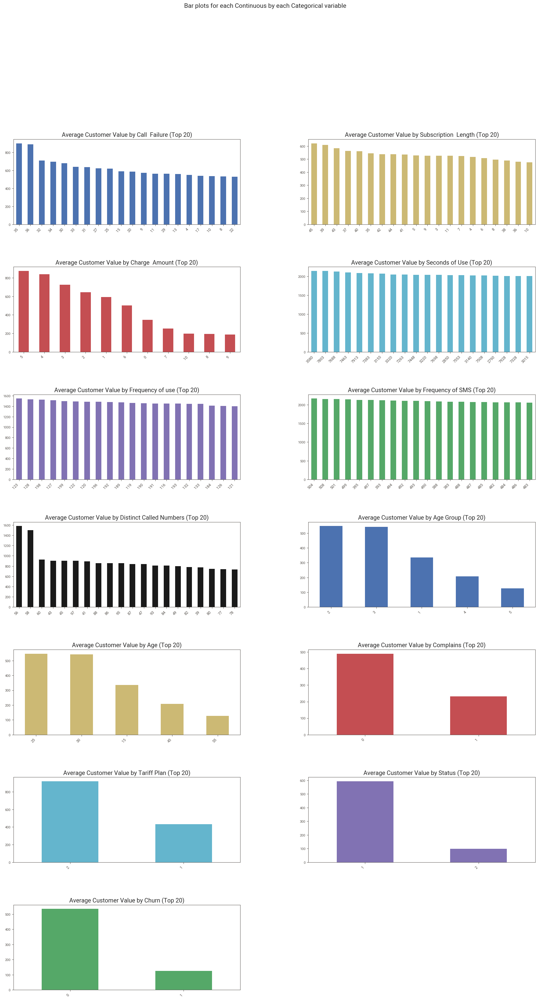

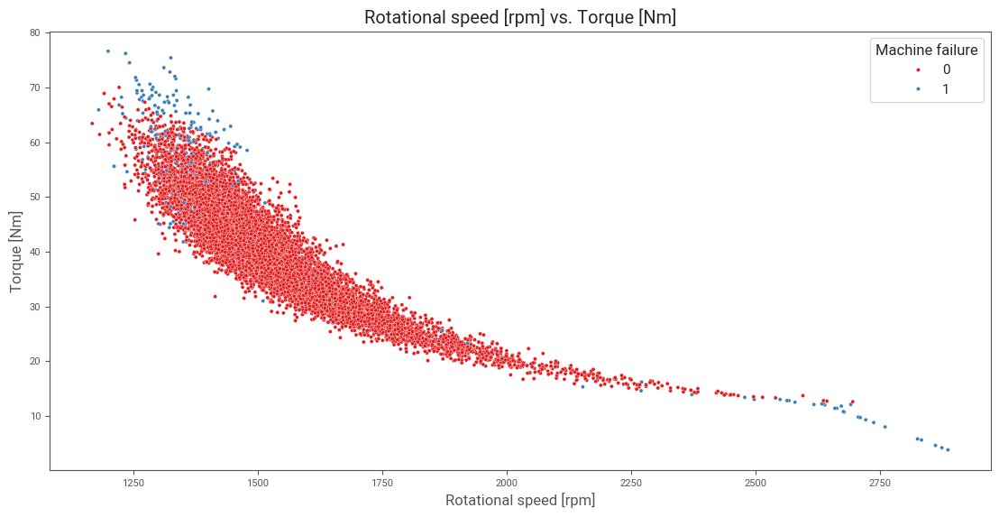

In [21]:
# Visualizing the Torque [Nm] and Rotational speed [rpm] columns with scatter plot
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df, x='Rotational speed [rpm]', y='Torque [Nm]', hue='Machine failure').set_title('Rotational speed [rpm] vs. Torque [Nm]')  

## <span style="color: #20C997;">Personal Analysis</span>
What I can see from scatterplot, machine fails in two conditions:<br>
Low speeds (<1500 rpm) with high torque (>60 Nm), which means when machine is loaded heavily, so it is overstrain.<br>
High speeds (>2500 rpm) with low torque (<20 Nm) which means machine works fast.<br>

Text(0.5, 1.0, 'Rotational speed [rpm] vs. Torque [Nm]')

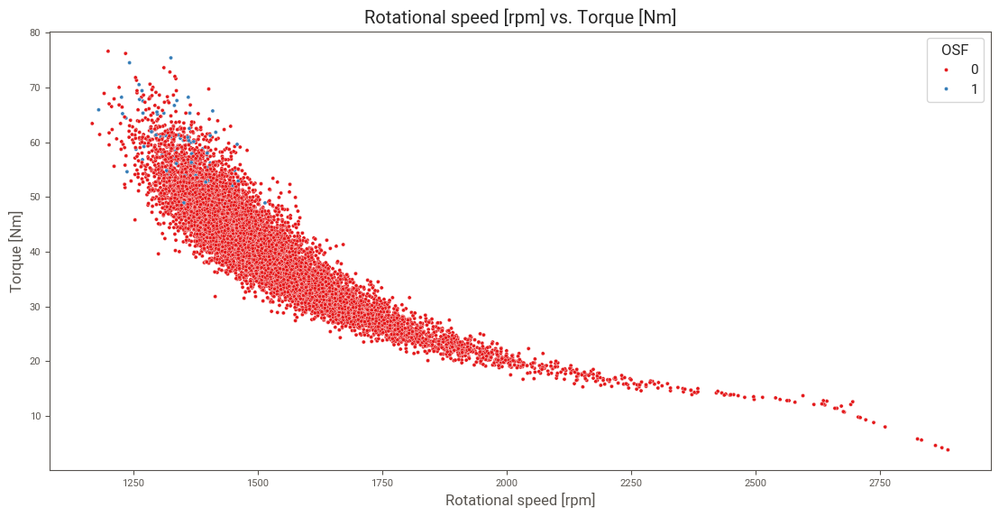

In [22]:
# let's check the now overstrain 
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df, x='Rotational speed [rpm]', y='Torque [Nm]', hue='OSF').set_title('Rotational speed [rpm] vs. Torque [Nm]')

## <span style="color: #20C997;">Personal Analysis</span>
Low speeds (<1500 rpm) with high torque (>60 Nm) is cause of overstrain but overstrain is not alone.<br>
Low speeds with high torque might cause of temperature.

Text(0.5, 1.0, 'Rotational speed [rpm] vs. Torque [Nm]')

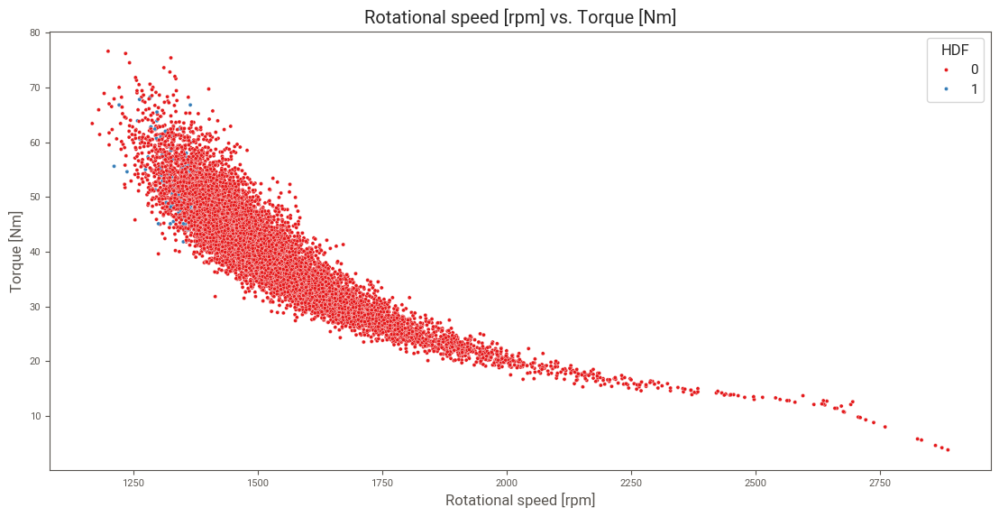

In [23]:
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df, x='Rotational speed [rpm]', y='Torque [Nm]', hue='HDF').set_title('Rotational speed [rpm] vs. Torque [Nm]')

## <span style="color: #20C997;">Personal Analysis</span>
Low speeds (<1500 rpm) with high torque (>60 Nm) is cause of HDF.<br>

Text(0.5, 1.0, 'Rotational speed [rpm] vs. Torque [Nm]')

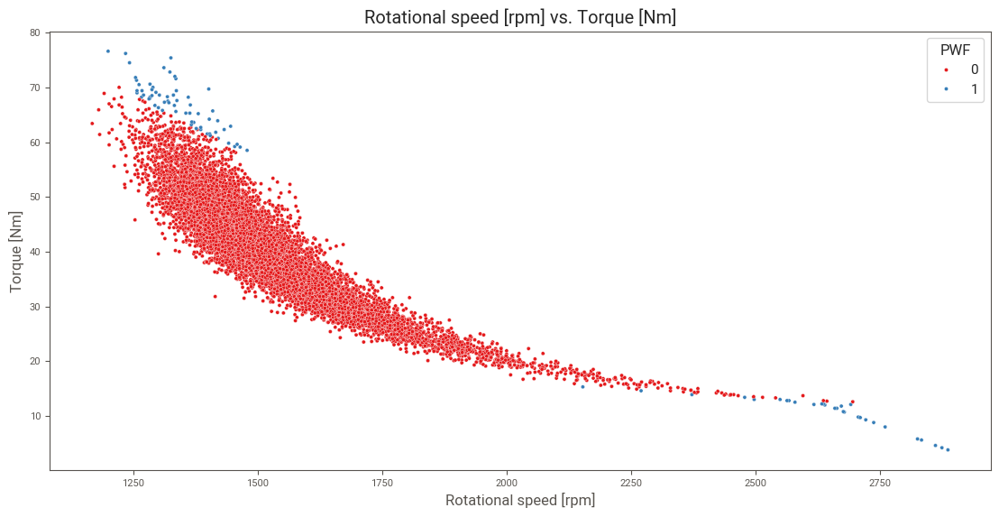

In [24]:
# Now let's find the high rotation speed and low torque values
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df, x='Rotational speed [rpm]', y='Torque [Nm]', hue='PWF').set_title('Rotational speed [rpm] vs. Torque [Nm]')  

## <span style="color: #20C997;">Personal Analysis</span>
Low speeds (<1500 rpm) with high torque (>60 Nm) and High speeds (>2500 rpm) with low torque (<20 Nm) are cause of power failure, which makes sense, in both situations power consumption goes up.<br>

Text(0.5, 1.0, 'Tool wear [min] vs. Torque [Nm] for OSF')

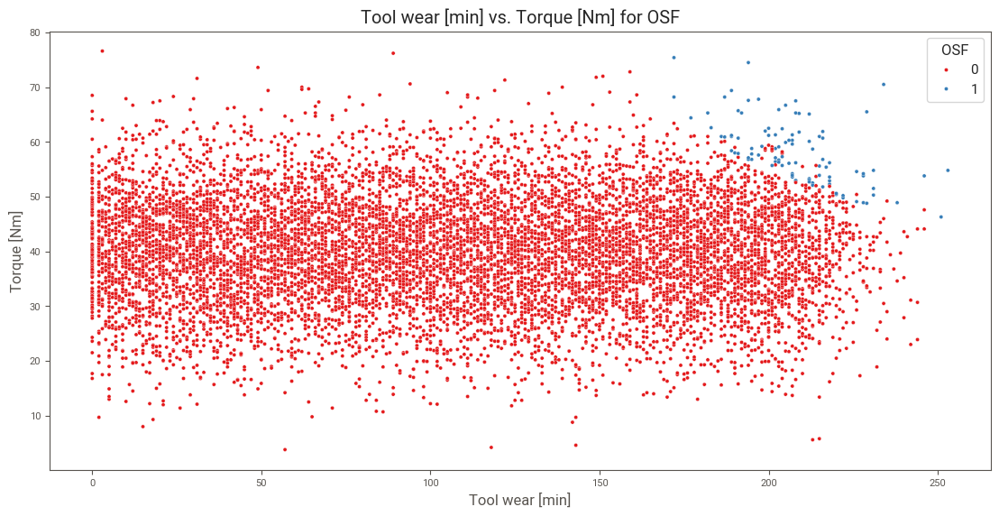

In [25]:
# Visualizing the Tool wear and Torque [Nm] for OSF
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df, x='Tool wear [min]', y='Torque [Nm]', hue='OSF').set_title('Tool wear [min] vs. Torque [Nm] for OSF')

## <span style="color: #20C997;">Personal Analysis:</span>
Scatter shows that high tool wear and high torque are cause of overstrain failure.

Text(0.5, 1.0, 'Air temperature [C] vs. Rotational speed [rpm] for HDF')

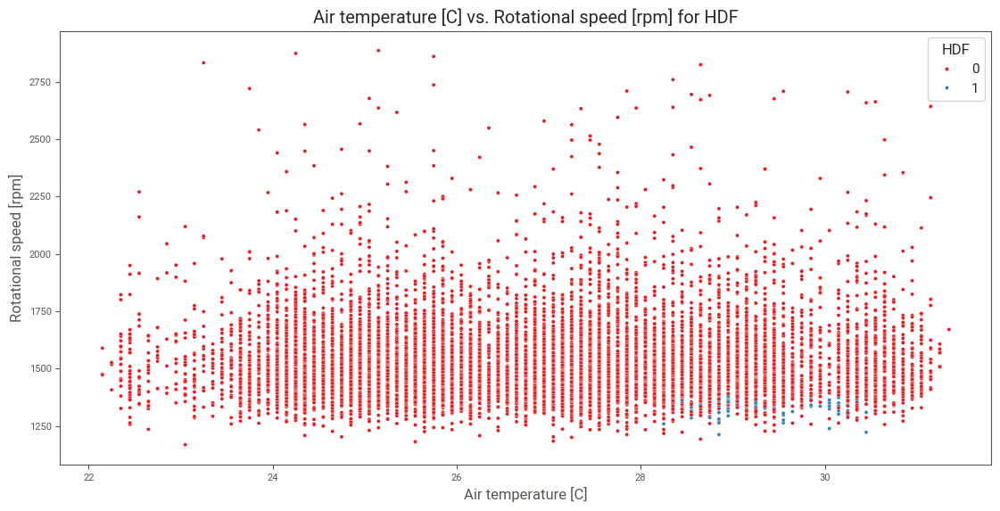

In [26]:
# Visualizing the Air temperature [C] and Rotational speed [rpm] for HDF
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df, x='Air temperature [C]', y='Rotational speed [rpm]', hue='HDF').set_title('Air temperature [C] vs. Rotational speed [rpm] for HDF')

## <span style="color: #20C997;">Personal Analysis:</span>
Higher air temperature is cause of HDF.

In [27]:
# Drop the Product ID column and Type column
df = df.drop(["Product ID", "Type"], axis=1)

In [28]:
X = df.drop("Machine failure", axis=1)
y = df["Machine failure"]

# convert all continuous variables to integer,
# and convert all negative numbers to 0
X_cat = X.astype(int)
X_cat = X_cat.clip(lower=0)

chi_features = SelectKBest(chi2, k=len(X_cat.columns))

# fit our data to the SelectKBest
best_features = chi_features.fit(X_cat, y.astype(int))

# use decimal format in table
pd.options.display.float_format = '{:.2f}'.format

# the higher the score, the more effect that column has on the target
df_features = pd.DataFrame(best_features.scores_)
df_columns = pd.DataFrame(X_cat.columns)
f_scores = pd.concat([df_columns, df_features], axis=1)
f_scores.columns = ['Features', 'Score']
f_scores.sort_values(by='Score', ascending=False)

,Features,Score
0,UDI,8733.04
5,Tool wear [min],4173.13
7,HDF,3277.33
9,OSF,2792.86
8,PWF,2707.36
6,TWF,1310.93
4,Torque [Nm],919.92
3,Rotational speed [rpm],407.82
1,Air temperature [C],10.19
2,Process temperature [C],0.80


## <span style="color: #20C997;">Personal Analysis:</span>
The most important factors for machine failure are Tool wear, UDI, HDF, OSF, and PWF.

In [31]:
data.head()

,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
0,8,0,38,0,4370,71,5,17,3,1,1,30,197.64,0
1,0,0,39,0,318,5,7,4,2,1,2,25,46.03,0
2,10,0,37,0,2453,60,359,24,3,1,1,30,1536.52,0
3,10,0,38,0,4198,66,1,35,1,1,1,15,240.02,0
4,3,0,38,0,2393,58,2,33,1,1,1,15,145.81,0


Text(0.5, 1.0, 'Seconds of use vs Customer value with Churn as hue')

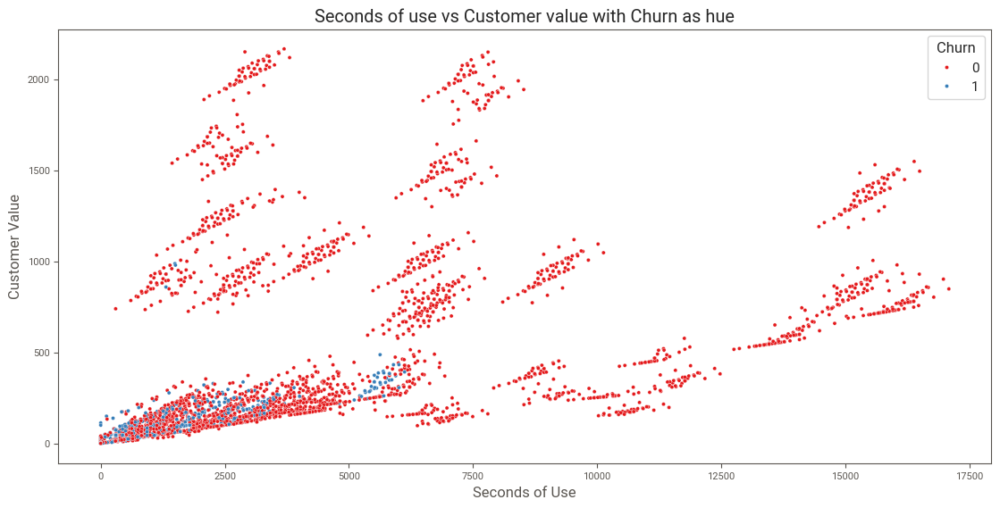

In [32]:
# Using scatterplot to visualize Seconds od use vs Customer value with churn as hue
plt.figure(figsize=(12, 6))
sns.scatterplot(data=data, x='Seconds of Use', y='Customer Value', hue='Churn').set_title('Seconds of use vs Customer value with Churn as hue')

## <span style="color: #20C997;">Personal Analysis:</span>
What I see from Scatter plot, a customer with low second of use and  low customer value has higher chance for 1 in churn.

In [33]:
data[data['Churn'] == 1].describe()

,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
count,495.00,495.00,495.00,495.00,495.00,495.00,495.00,495.00,495.00,495.00,495.00,495.00,495.00,495.00
mean,7.48,0.40,31.89,0.23,1566.63,29.13,15.80,12.39,2.80,1.01,1.75,30.64,124.81,1.00
std,7.83,0.49,9.47,0.62,1539.20,26.32,23.52,10.87,0.71,0.11,0.43,6.89,129.43,0.00
min,0.00,0.00,3.00,0.00,0.00,0.00,0.00,0.00,2.00,1.00,1.00,25.00,0.00,1.00
25%,0.00,0.00,31.00,0.00,318.00,6.00,0.00,2.00,2.00,1.00,1.00,25.00,38.38,1.00
50%,5.00,0.00,35.00,0.00,1182.00,25.00,9.00,10.00,3.00,1.00,2.00,30.00,96.84,1.00
75%,11.00,1.00,37.00,0.00,2391.50,45.50,23.00,20.00,3.00,1.00,2.00,30.00,181.32,1.00
max,34.00,1.00,45.00,4.00,6123.00,100.00,204.00,48.00,5.00,2.00,2.00,55.00,987.25,1.00


In [34]:
data[data['Churn'] == 0].describe()

,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
count,2655.00,2655.00,2655.00,2655.00,2655.00,2655.00,2655.00,2655.00,2655.00,2655.00,2655.00,2655.00,2655.00,2655.00
mean,7.66,0.02,32.66,1.08,5014.22,76.98,83.87,25.58,2.83,1.09,1.16,31.07,535.51,0.00
std,7.15,0.12,8.39,1.60,4312.74,58.50,118.81,17.39,0.92,0.29,0.36,9.15,536.21,0.00
min,0.00,0.00,3.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,15.00,0.00,0.00
25%,1.00,0.00,29.00,0.00,1819.00,32.00,7.00,12.00,2.00,1.00,1.00,25.00,142.06,0.00
50%,6.00,0.00,35.00,0.00,3530.00,63.00,25.00,23.00,3.00,1.00,1.00,30.00,268.07,0.00
75%,12.00,0.00,38.00,2.00,6892.50,104.00,133.00,36.00,3.00,1.00,1.00,30.00,864.55,0.00
max,36.00,1.00,47.00,10.00,17090.00,255.00,522.00,97.00,5.00,2.00,2.00,55.00,2165.28,0.00


## <span style="color: #20C997;">Personal Analysis:</span>
Churned customers use the service less, complain more, and bring less value.<br>
High usage and value customers are less likely to leave.